In [1]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

import matplotlib as mpl
# enables correct plotting of text
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42 

import scanpy.external as sce

In [2]:
import session_info
session_info.show()

/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/session_info/main.py:213: UserWarning: The '__version__' attribute is deprecated and will be removed in MarkupSafe 3.1. Use feature detection, or `importlib.metadata.version("markupsafe")`, instead.
  mod_version = _find_version(mod.__version__)


In [3]:
import importlib.util
import sys
spec = importlib.util.spec_from_file_location("module.name", "/home/kk837/rfs/rfs-teichlab-nfs-iCNyzSAaucw/kk837/function/python/utils.py")
utils = importlib.util.module_from_spec(spec)
sys.modules["module.name"] = utils
spec.loader.exec_module(utils)

In [4]:
sc.settings.set_figure_params(dpi=80)

# Variables

In [5]:
adata_dir = '/home/kk837/rds/rds-teichlab-C9woKbOCf2Y/kk837/Foetal/anndata_objects/Xenium/subsets'
sample_id = 'C194-HEA-0-FFPE-1_Hst45-HEA-0-FFPE-1_concat'
celltype = 'AtrialCardiomyocytes'

In [6]:
# figdir = '/nfs/team205/heart/fetal_ms_figures/raw_plots_kk/Aug2024'
# table_dir = '/nfs/team205/heart/fetal_ms_figures/tables/Aug2024'

In [7]:
latent_space = 'pca_harmony'

# Read in data

In [8]:
# read in
adata = sc.read_h5ad(f'{adata_dir}/{sample_id}_5K_{celltype}_lognorm.h5ad')
adata

AnnData object with n_obs × n_vars = 47076 × 5000
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'n_genes', 'tissue_block_id', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'pca_harmony_leiden_0.2', 'pca_harmony_leiden_0.3', 'pca_harmony_leiden_0.4', 'pca_harmony_leiden_0.5', 'pca_harmony_leiden_0.8', 'pca_harmony_leiden_1.0', 'pca_harmony_leiden_1.5', 'pca_harmony_leiden_2.0', 'pca_harmony_leiden_3

In [9]:
adata.X.data[:5]

array([3.5825472, 3.5825472, 3.5825472, 3.5825472, 3.5825472],
      dtype=float32)

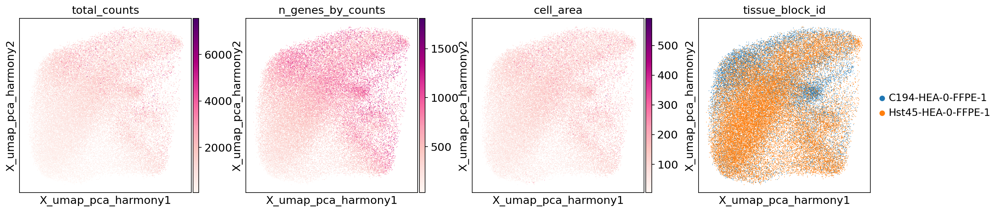

In [10]:
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                color=['total_counts','n_genes_by_counts','cell_area','tissue_block_id'],
                    wspace=0.2,cmap='RdPu',vmax='p100')

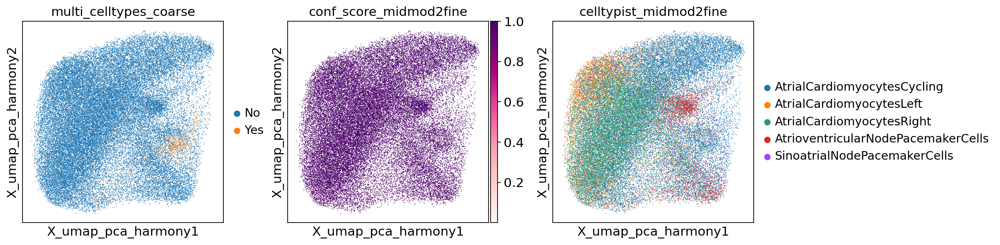

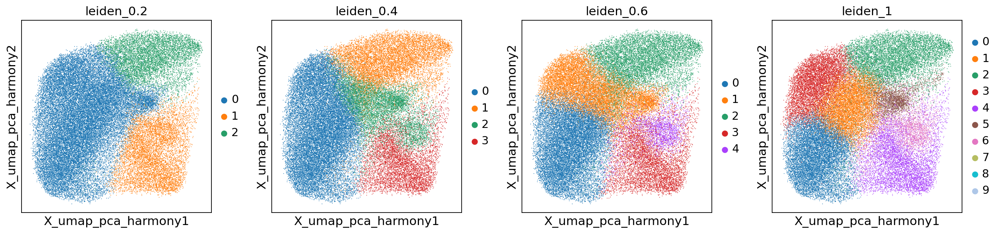

In [11]:
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                color=['multi_celltypes_coarse',"conf_score_midmod2fine","celltypist_midmod2fine",],
                    wspace=0.2,cmap='RdPu',vmax='p100')
resolutions_list = [0.2,0.4,0.6,1]
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                    color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                    wspace=0.2)

<timed exec>:5: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.


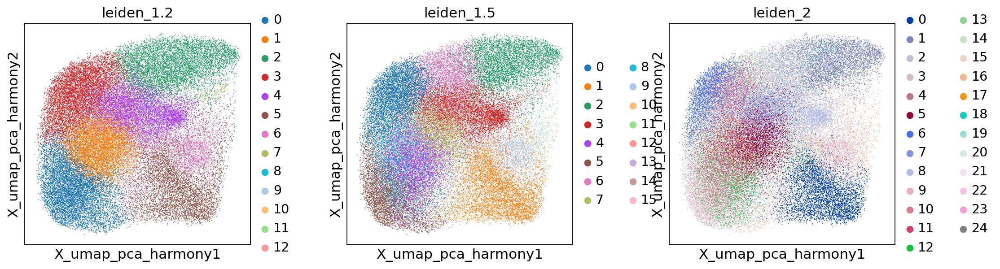

CPU times: user 50.2 s, sys: 400 ms, total: 50.6 s
Wall time: 50.7 s


In [12]:
%%time
# leiden clustering
resolutions_list = [# 0.2,0.4,0.6,1, # already done
                    1.2,1.5,2]
for resolution in resolutions_list:
    sc.tl.leiden(adata,neighbors_key=latent_space,
                     resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                wspace=0.3)

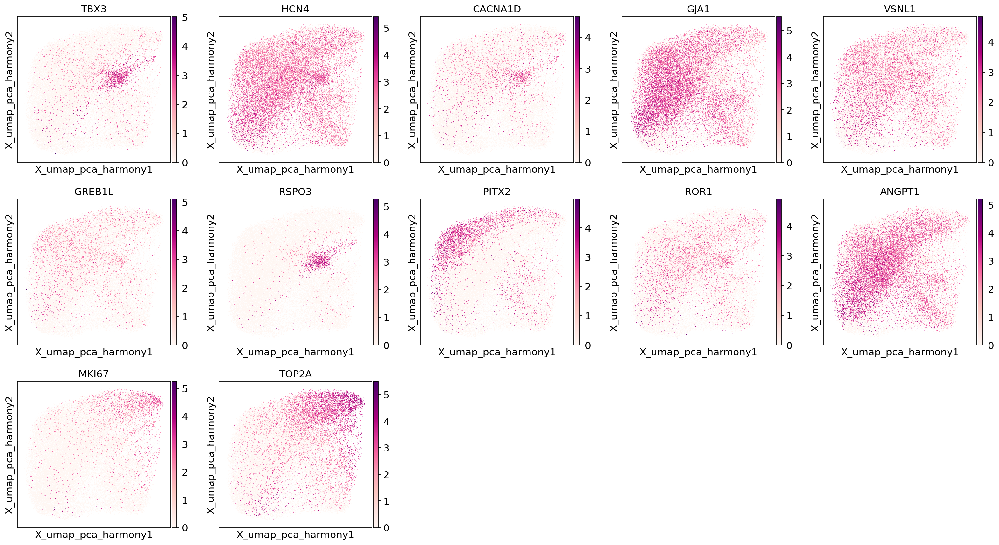

In [13]:
# check marker expressions
genes = ['TBX3','TBX18','SHOX2','HCN1','HCN4','CACNA1D', 'GJA1','VSNL1',# SANPC
         'GREB1L','GNG11','NRXN3','RSPO3', # AVNPC
         'PITX2','KCNMB2','PCDH7','RYR3','MBP', # aCM_left
         'NTM','ROR1','KIF26B','PLCL1','ANGPT1', # aCM_right
         'NKX2-5','MKI67','TOP2A'
        ]
genes = [x for x in genes if x in adata.var_names]
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                color=genes,
               ncols=5, wspace=0.2,cmap='RdPu',vmax='p100')

# Annotate low quality cells as "unclassified"

In [14]:
resolution_sel = 1.5

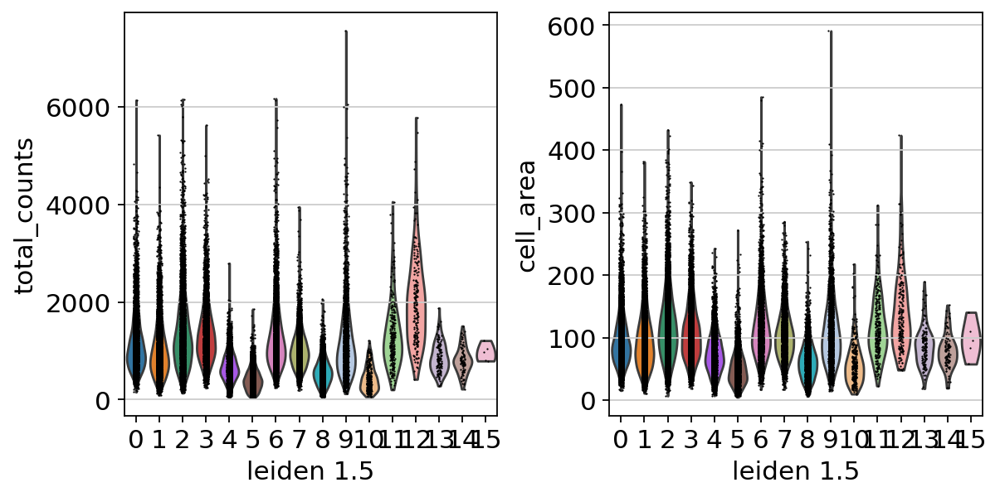

In [15]:
sc.pl.violin(adata,keys=['total_counts','cell_area'],groupby=f'leiden_{str(resolution_sel)}')

--> cluster 4,5,8,10 has lower total counts and smaller cell area --> annotate as "unclassified"

In [16]:
# annotate
adata.obs['tmp_annotation'] = adata.obs[f'leiden_{str(resolution_sel)}'].copy()
adata.obs.replace({'tmp_annotation':{
    '0':'AtrialCardiomyocytes',
    '1':'AtrialCardiomyocytes',
    '2':'AtrialCardiomyocytes',
    '3':'AtrialCardiomyocytes',
    '4':'unclassified',
    '5':'unclassified',
    '6':'AtrialCardiomyocytes',
    '7':'AtrialCardiomyocytes',
    '8':'unclassified',
    '9':'AtrialCardiomyocytes',
    '10':'unclassified',
    '11':'AtrialCardiomyocytes',
    '12':'AtrialCardiomyocytes',
    '13':'AtrialCardiomyocytes',
    '14':'AtrialCardiomyocytes',
    '15':'AtrialCardiomyocytes',
}},inplace=True)
adata.obs['tmp_annotation'].value_counts()

/tmp/ipykernel_60220/1768720550.py:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs.replace({'tmp_annotation':{


tmp_annotation
AtrialCardiomyocytes    33947
unclassified            13129
Name: count, dtype: int64

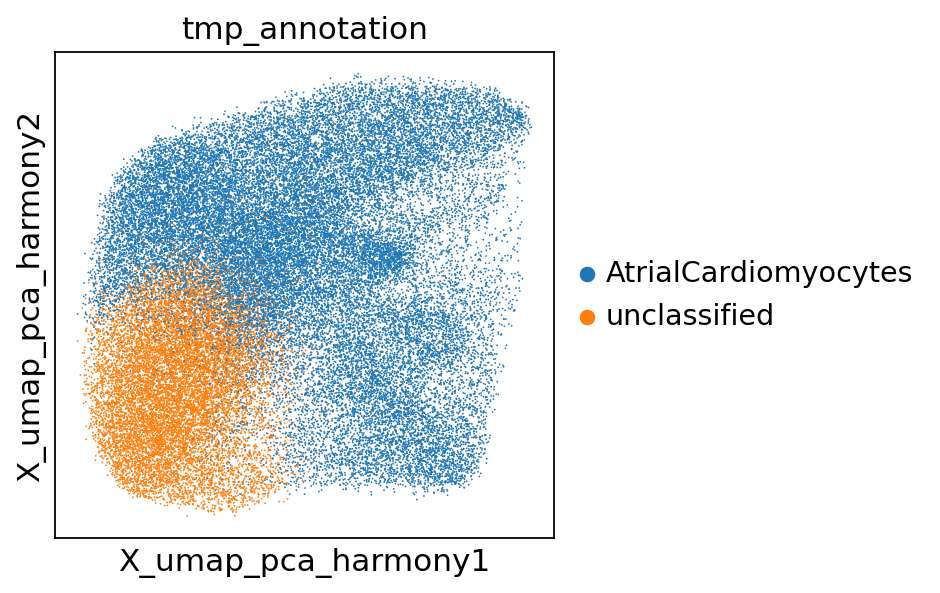

In [17]:
sc.pl.embedding(adata, basis=f"X_umap_{latent_space}",
                color='tmp_annotation',
               ncols=5, wspace=0.2)

# Subset and reclustering

In [18]:
adata_sub = adata[adata.obs['tmp_annotation']=='AtrialCardiomyocytes']

In [19]:
# drop leiden clustering results
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    adata_sub.obs.drop(f'leiden_{str(resolution)}',axis=1,inplace=True)
adata_sub

AnnData object with n_obs × n_vars = 33947 × 5000
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'n_genes', 'tissue_block_id', 'celltypist_coarse', 'conf_score_coarse', 'celltypist_coarse_fin', 'celltypist_coarse2midmod', 'conf_score_coarse2midmod', 'celltypist_mid_fin', 'celltypist_midmod2fine', 'conf_score_midmod2fine', 'pca_harmony_leiden_0.2', 'pca_harmony_leiden_0.3', 'pca_harmony_leiden_0.4', 'pca_harmony_leiden_0.5', 'pca_harmony_leiden_0.8', 'pca_harmony_leiden_1.0', 'pca_harmony_leiden_1.5', 'pca_harmony_leiden_2.0', 'pca_harmony_leiden_3

In [20]:
# HVGs
# sc.pp.highly_variable_genes(adata_sub, flavor='seurat', min_mean=0.0125, max_mean=3, min_disp=0.5)
# print(f'number of hvgs: {sum(adata_sub.var.highly_variable)}')
# PCA
sc.tl.pca(adata_sub, use_highly_variable=False)
# harmony integration
sce.pp.harmony_integrate(adata_sub, 'tissue_block_id', basis='X_pca', adjusted_basis='X_pca_harmony')
# create neighbour graph
latent_space = 'pca_harmony'
sc.pp.neighbors(adata_sub,n_neighbors=15,use_rep=f"X_{latent_space}",key_added=latent_space)
# visualisation with umap
sc.tl.umap(adata_sub,min_dist=0.5,neighbors_key=latent_space)
adata_sub.obsm[f"X_umap_{latent_space}"]=adata_sub.obsm["X_umap"]
del adata_sub.obsm["X_umap"]

/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/preprocessing/_pca/__init__.py:438: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
2025-06-09 20:36:42,658 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-09 20:36:46,050 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-09 20:36:46,145 - harmonypy - INFO - Iteration 1 of 10
2025-06-09 20:36:51,846 - harmonypy - INFO - Iteration 2 of 10
2025-06-09 20:36:57,428 - harmonypy - INFO - Converged after 2 iterations
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm

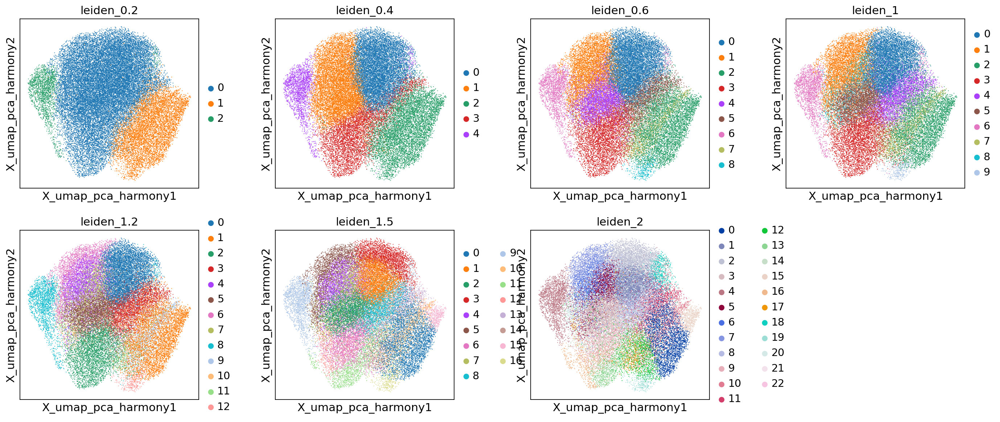

CPU times: user 55.8 s, sys: 561 ms, total: 56.4 s
Wall time: 56.5 s


In [21]:
%%time
# reclustering
# leiden clustering
resolutions_list = [0.2,0.4,0.6,1, 1.2,1.5,2]
for resolution in resolutions_list:
    sc.tl.leiden(adata_sub,neighbors_key=latent_space,
                 resolution=resolution,key_added=f'leiden_{str(resolution)}',n_iterations=2)
sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                color=[f'leiden_{str(resolution)}' for resolution in resolutions_list],
                wspace=0.3)

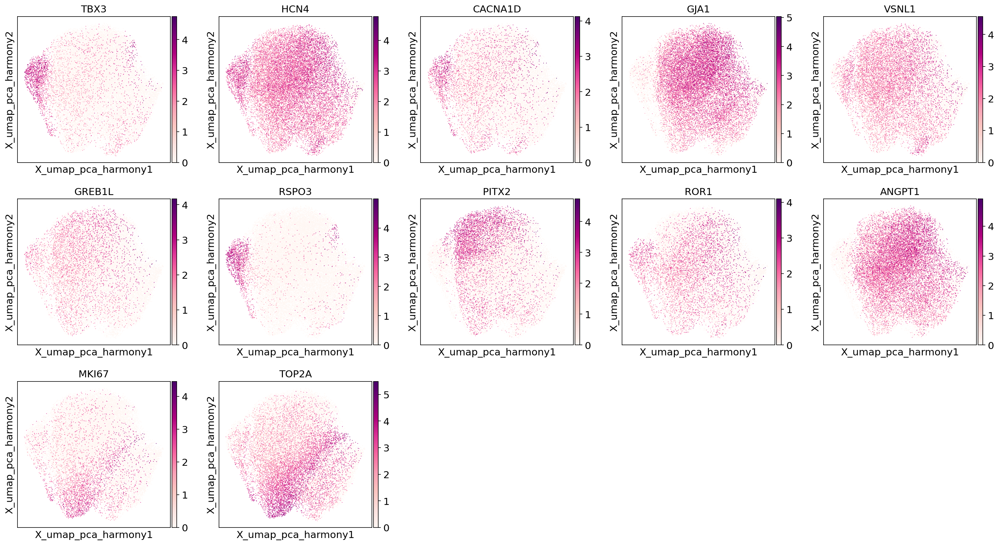

In [22]:
genes = ['TBX3','TBX18','SHOX2','HCN1','HCN4','CACNA1D', 'GJA1','VSNL1',# SANPC
         'GREB1L','GNG11','NRXN3','RSPO3', # AVNPC
         'PITX2','KCNMB2','PCDH7','RYR3','MBP', # aCM_left
         'NTM','ROR1','KIF26B','PLCL1','ANGPT1', # aCM_right
         'NKX2-5','MKI67','TOP2A'
        ]
genes = [x for x in genes if x in adata_sub.var_names]
sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                color=genes,
               ncols=5, wspace=0.2,cmap='RdPu',vmax='p100')

In [29]:
sub_resolution_sel = 2

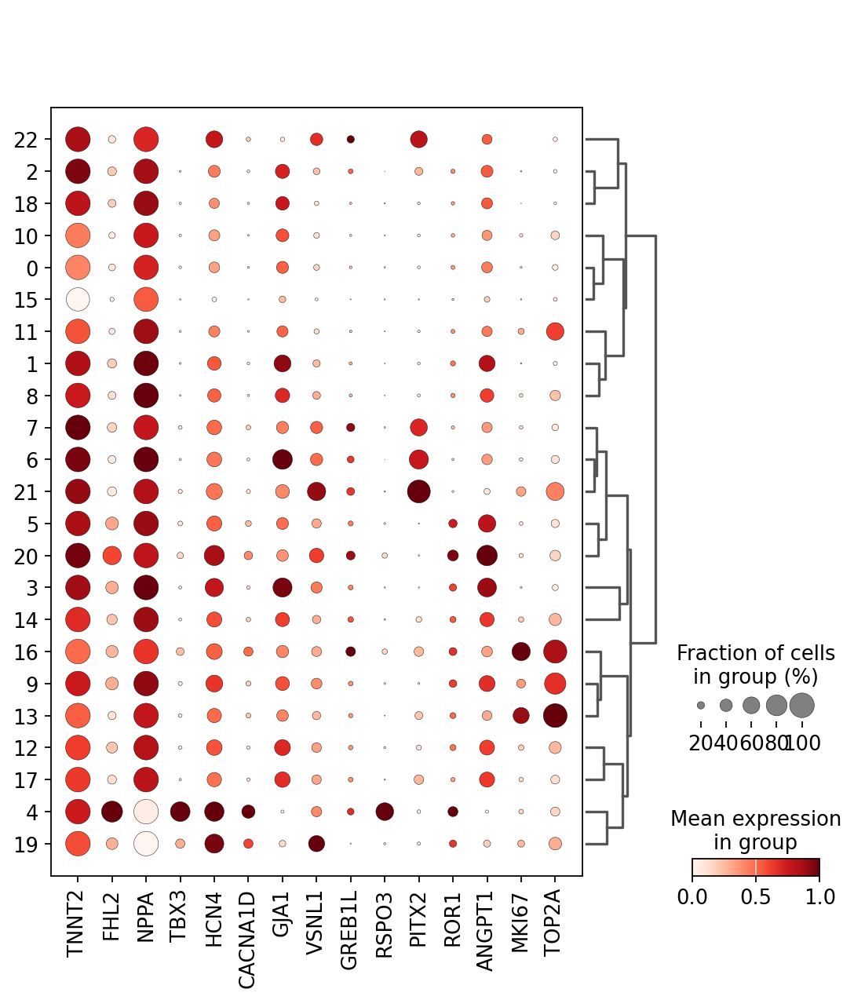

In [30]:
genes = ['TTN', 'TNNT2','MYH6', # generic CM marker
        'MYH7', 'MYL2', 'FHL2', # vCN
            'NPPA', 'MYL7', 'MYL4', #aCM
    'TBX3','TBX18','SHOX2','HCN1','HCN4','CACNA1D', 'GJA1','VSNL1',# SANPC
         'GREB1L','GNG11','NRXN3','RSPO3', # AVNPC
         'PITX2','KCNMB2','PCDH7','RYR3','MBP', # aCM_left
         'NTM','ROR1','KIF26B','PLCL1','ANGPT1', # aCM_right
         'MKI67','TOP2A','NKX2-5'
        ]
genes = [x for x in genes if x in adata.var_names]

sc.tl.dendrogram(adata_sub,groupby=f'leiden_{str(sub_resolution_sel)}')
sc.pl.dotplot(adata_sub,
              var_names=genes,
              groupby=f'leiden_{str(sub_resolution_sel)}',
              standard_scale='var',
              dendrogram=True
             )

[2.4920871 2.4920871 3.1429856 2.4920871 4.3644395]


/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:463: Perf

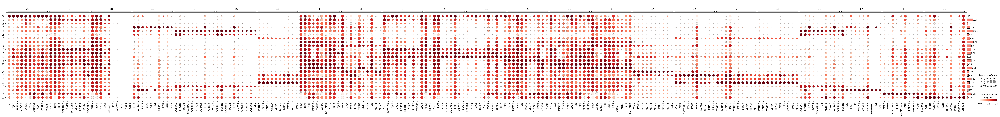

In [31]:
# DEG analysis
print(adata_sub.X.data[:5])
adata_sub.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_sub,groupby=f'leiden_{str(sub_resolution_sel)}')
sc.tl.dendrogram(adata_sub, groupby=f'leiden_{str(sub_resolution_sel)}')
dp=sc.pl.rank_genes_groups_dotplot(adata_sub, dendrogram=True, standard_scale='var', return_fig=True)
dp.add_totals().show()

--> CXCL12 expression in SAN-PC??<br>
--> cluster 0,10,15,12,17 are likely to be "doublets" (high expression of other cell type markers, such as POSTN, KDR)

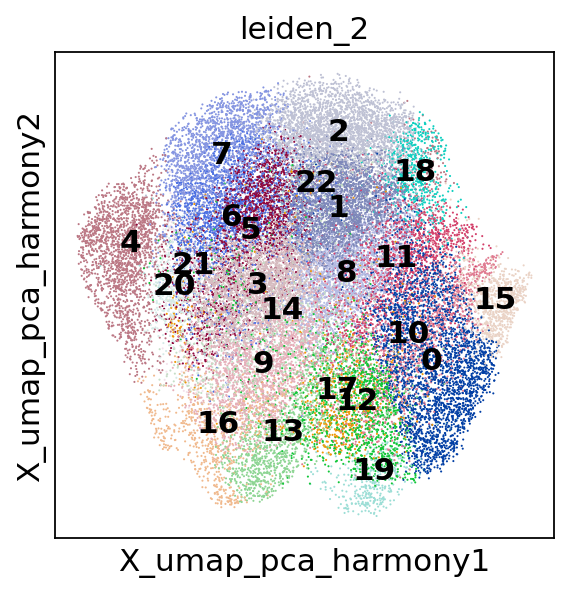

In [32]:
sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                color=f'leiden_{str(sub_resolution_sel)}',legend_loc='on data',
                wspace=0.3)

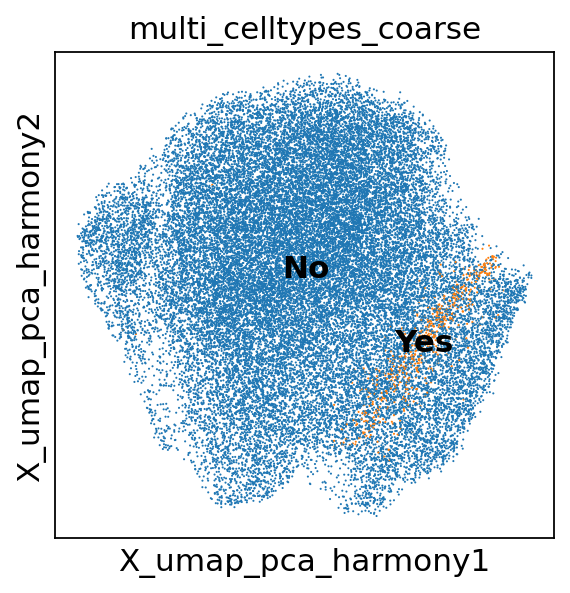

In [33]:
sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                color=f'multi_celltypes_coarse',legend_loc='on data',
                wspace=0.3)

In [34]:
# annotate
adata_sub.obs['fine_grain_manual'] = adata_sub.obs[f'leiden_{str(sub_resolution_sel)}'].copy()
adata_sub.obs.replace({'fine_grain_manual':{
    '0':'AtrialCardiomyocytes_DoubletWithFB',
    '1':'AtrialCardiomyocytesRight',
    '2':'AtrialCardiomyocytesLeft',
    '3':'AtrialCardiomyocytesRight',
    '4':'AtrioventricularNodePacemakerCells',
    '5':'AtrialCardiomyocytesRight',
    '6':'AtrialCardiomyocytesLeft',
    '7':'AtrialCardiomyocytesLeft',
    '8':'AtrialCardiomyocytesCycling',
    '9':'AtrialCardiomyocytesCycling',
    '10':'AtrialCardiomyocytes_DoubletWithEC',
    '11':'AtrialCardiomyocytesCycling',
    '12':'AtrialCardiomyocytes_DoubletWithFB',
    '13':'AtrialCardiomyocytesCycling',
    '14':'AtrialCardiomyocytesRight',
    '15':'AtrialCardiomyocytes_DoubletWithFB',
    '16':'AtrialCardiomyocytesCycling',
    '17':'AtrialCardiomyocytes_DoubletWithEC',
    '18':'AtrialCardiomyocytesRight',
    '19':'SinoatrialNodePacemakerCells',
    '20':'AtrialCardiomyocytesRight',
    '21':'AtrialCardiomyocytesLeft',
    '22':'AtrialCardiomyocytesLeft',
}},inplace=True)
adata_sub.obs['fine_grain_manual'].value_counts()

/tmp/ipykernel_60220/1879809394.py:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata_sub.obs.replace({'fine_grain_manual':{


fine_grain_manual
AtrialCardiomyocytesRight             9633
AtrialCardiomyocytesLeft              7206
AtrialCardiomyocytesCycling           7112
AtrialCardiomyocytes_DoubletWithFB    5201
AtrialCardiomyocytes_DoubletWithEC    2232
AtrioventricularNodePacemakerCells    2085
SinoatrialNodePacemakerCells           478
Name: count, dtype: int64

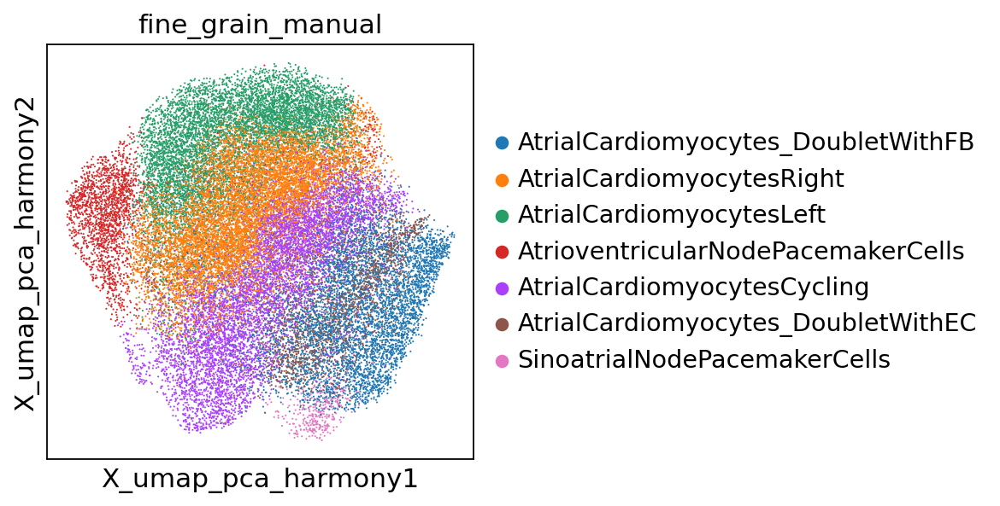

In [35]:
sc.pl.embedding(adata_sub, basis=f"X_umap_{latent_space}",
                color='fine_grain_manual',
                wspace=0.3)

# Transfer annotation to the original adata

In [36]:
adata.obs['fine_grain_manual'] = 'unclassified'
adata.obs.loc[adata_sub.obs_names,'fine_grain_manual'] = adata_sub.obs['fine_grain_manual']

/tmp/ipykernel_60220/681652047.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],# groups='SinoatrialNodePacemakerCells',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


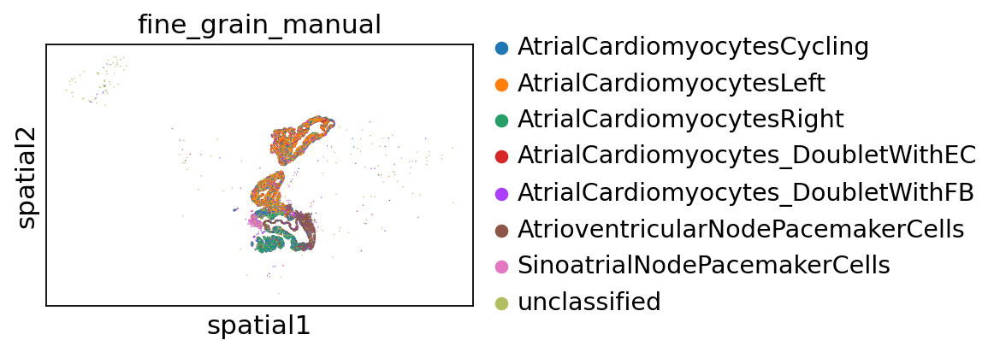

/tmp/ipykernel_60220/681652047.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],# groups='SinoatrialNodePacemakerCells',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


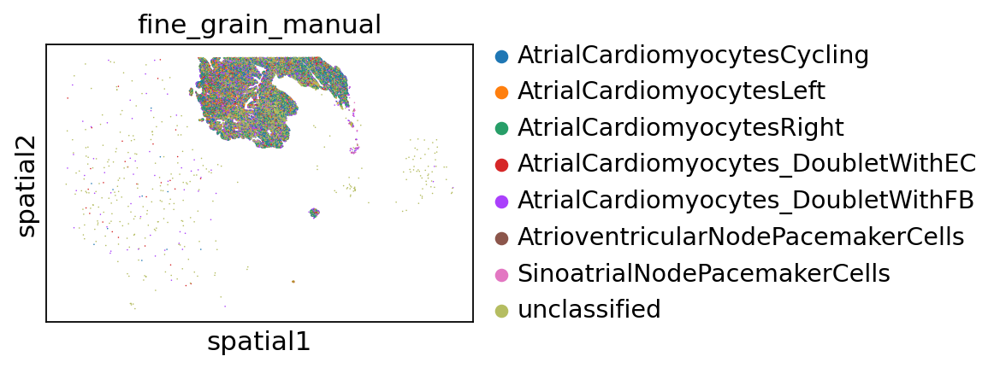

In [37]:
for tissue_id in ['C194-HEA-0-FFPE-1', 'Hst45-HEA-0-FFPE-1']:
    slide = adata[adata.obs['tissue_block_id']==tissue_id]
    sc.pl.spatial(slide,color=['fine_grain_manual'],# groups='SinoatrialNodePacemakerCells',
                  spot_size=30,vmax='p100')

/tmp/ipykernel_60220/1370592205.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],groups='SinoatrialNodePacemakerCells',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


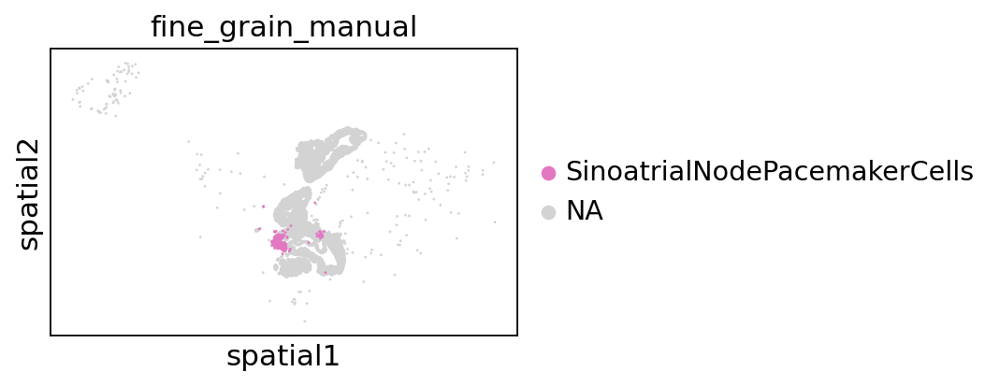

/tmp/ipykernel_60220/1370592205.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],groups='SinoatrialNodePacemakerCells',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


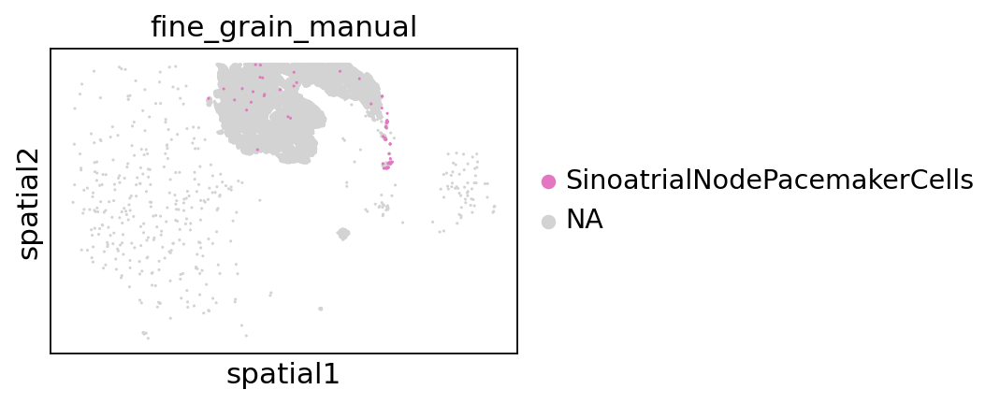

In [38]:
for tissue_id in ['C194-HEA-0-FFPE-1', 'Hst45-HEA-0-FFPE-1']:
    slide = adata[adata.obs['tissue_block_id']==tissue_id]
    sc.pl.spatial(slide,color=['fine_grain_manual'],groups='SinoatrialNodePacemakerCells',
                  spot_size=60,vmax='p100')

/tmp/ipykernel_60220/2612643899.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


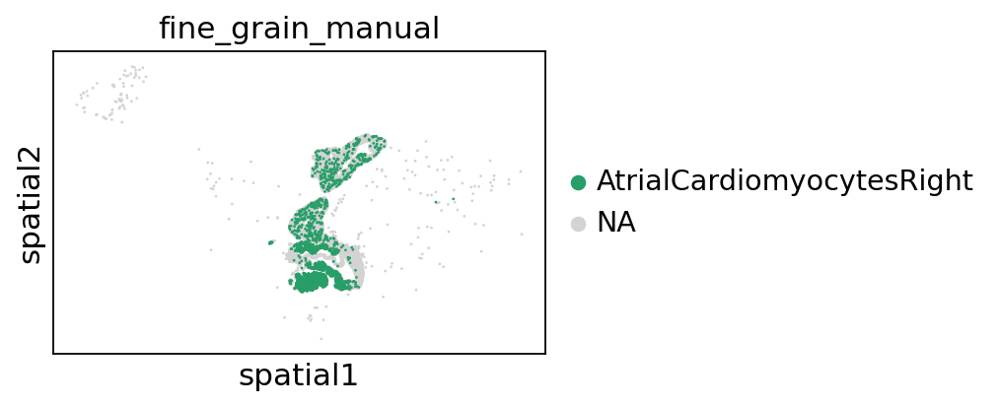

/tmp/ipykernel_60220/2612643899.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


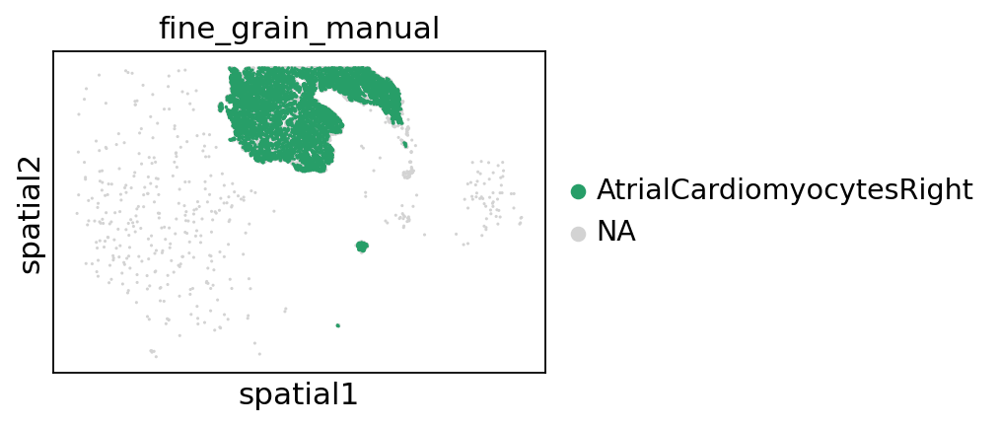

In [39]:
for tissue_id in ['C194-HEA-0-FFPE-1', 'Hst45-HEA-0-FFPE-1']:
    slide = adata[adata.obs['tissue_block_id']==tissue_id]
    sc.pl.spatial(slide,color=['fine_grain_manual'],
                  groups=['AtrialCardiomyocytesRight'],
                  spot_size=60,vmax='p100')

/tmp/ipykernel_60220/3050971786.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


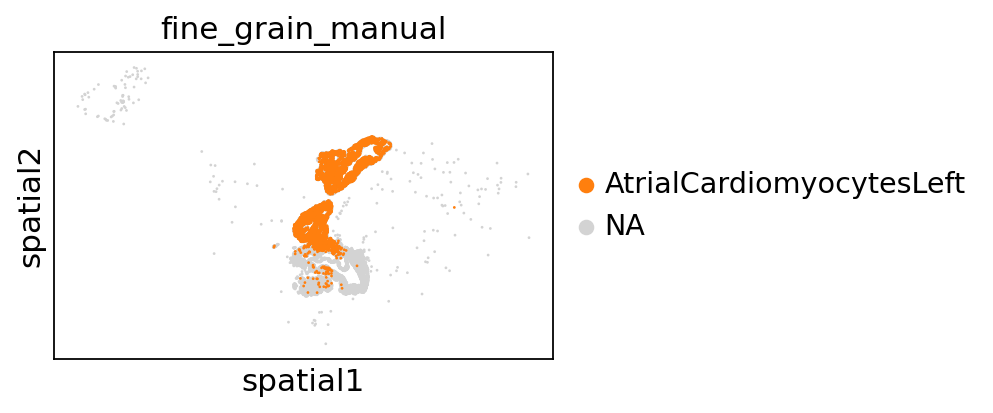

/tmp/ipykernel_60220/3050971786.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['fine_grain_manual'],
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


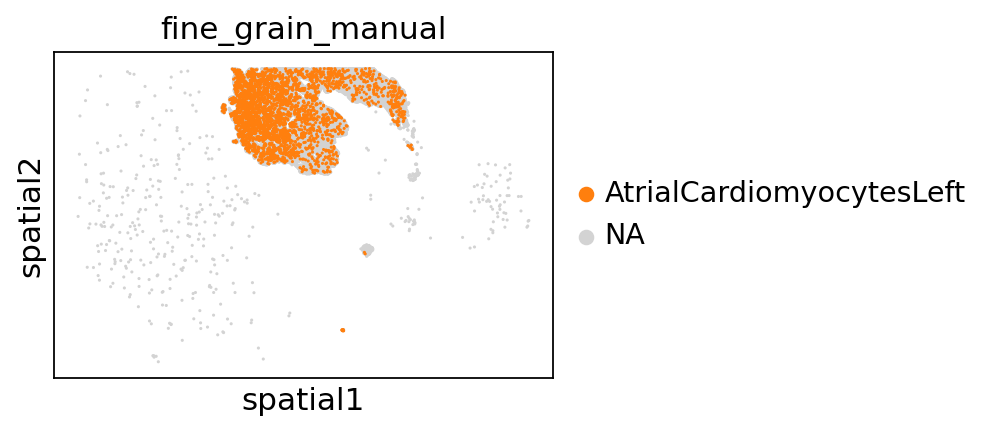

In [40]:
for tissue_id in ['C194-HEA-0-FFPE-1', 'Hst45-HEA-0-FFPE-1']:
    slide = adata[adata.obs['tissue_block_id']==tissue_id]
    sc.pl.spatial(slide,color=['fine_grain_manual'],
                  groups=['AtrialCardiomyocytesLeft'],
                  spot_size=60,vmax='p100')

/tmp/ipykernel_60220/2026526932.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['CXCL12'],cmap='RdPu',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


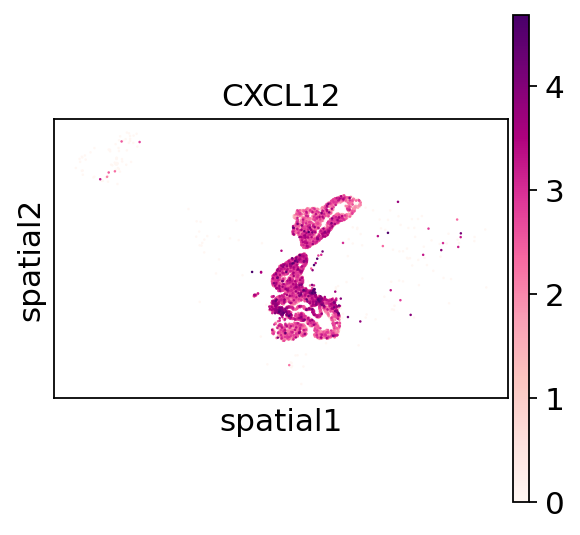

/tmp/ipykernel_60220/2026526932.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(slide,color=['CXCL12'],cmap='RdPu',
/home/kk837/.conda/envs/generic_env/lib/python3.10/site-packages/anndata/_core/anndata.py:1138: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


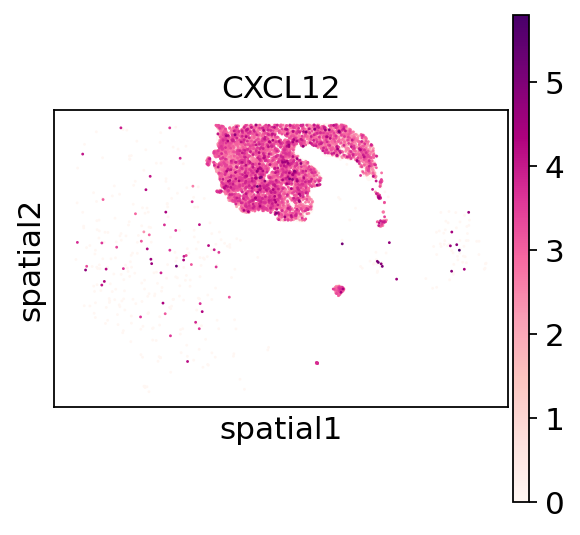

In [41]:
for tissue_id in ['C194-HEA-0-FFPE-1', 'Hst45-HEA-0-FFPE-1']:
    slide = adata[adata.obs['tissue_block_id']==tissue_id]
    sc.pl.spatial(slide,color=['CXCL12'],cmap='RdPu',
                  spot_size=60,vmax='p100')

# Save

In [42]:
# save
adata.write(f'{adata_dir}/{sample_id}_5K_{celltype}_lognorm.h5ad')
print(f'{adata_dir}/{sample_id}_5K_{celltype}_lognorm.h5ad')

/home/kk837/rds/rds-teichlab-C9woKbOCf2Y/kk837/Foetal/anndata_objects/Xenium/subsets/C194-HEA-0-FFPE-1_Hst45-HEA-0-FFPE-1_concat_5K_AtrialCardiomyocytes_lognorm.h5ad
